# Task 1: Filters Visualization
## 1.1 - Load VGG16
We are loading a (pretrained) VGG16 via torchvision

In [1]:
import numpy as np
import os
import torch
from torch.optim import Adam
from torchvision import models
from filters_visualization import visualise_layer_filter
from aux_ops import preprocess_image, recreate_image

model = models.vgg16(pretrained=True).features

model

/Users/flyboy/Documents/LMU/SoSe 25/GenAI/.venv/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/flyboy/Documents/LMU/SoSe 25/GenAI/.venv/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (17): Conv2d(256, 512, kernel_si

## 1.2 - Optimize input image


In [2]:
from matplotlib import pyplot as plt

In [3]:
activations = {}
def get_activation(name):
    def hook(model, input, output):
        activation = output.detach()
        activations[name] = {
            'shape': activation.shape,
            'mean': activation.mean().item(),
            'min': activation.min().item(),
            'max': activation.max().item()
        }
    return hook

for name, layer in model.named_modules():
    layer.register_forward_hook(get_activation(name))

In [4]:
input_tensor = torch.randn(1, 3, 224, 224)
output = model(input_tensor)

In [5]:
for name, activation in activations.items():
    print(f"Activation from layer {name}:\nSHAPE: {activation['shape']}\nMEAN: {activation['mean']}\nMIN: {activation['min']} MAX: {activation['max']}\n")


Activation from layer 0:
SHAPE: torch.Size([1, 64, 224, 224])
MEAN: -0.06500924378633499
MIN: -9.389382362365723 MAX: 11.06394100189209

Activation from layer 1:
SHAPE: torch.Size([1, 64, 224, 224])
MEAN: 0.49204155802726746
MIN: 0.0 MAX: 11.06394100189209

Activation from layer 2:
SHAPE: torch.Size([1, 64, 224, 224])
MEAN: -0.5154026746749878
MIN: -35.537109375 MAX: 35.894927978515625

Activation from layer 3:
SHAPE: torch.Size([1, 64, 224, 224])
MEAN: 1.2180242538452148
MIN: 0.0 MAX: 35.894927978515625

Activation from layer 4:
SHAPE: torch.Size([1, 64, 112, 112])
MEAN: 2.872053861618042
MIN: 0.0 MAX: 35.894927978515625

Activation from layer 5:
SHAPE: torch.Size([1, 128, 112, 112])
MEAN: -4.590533256530762
MIN: -60.1949348449707 MAX: 39.903263092041016

Activation from layer 6:
SHAPE: torch.Size([1, 128, 112, 112])
MEAN: 1.555521011352539
MIN: 0.0 MAX: 39.903263092041016

Activation from layer 7:
SHAPE: torch.Size([1, 128, 112, 112])
MEAN: -3.6741039752960205
MIN: -71.7365951538086 

## Task 1.3 - Visualize a random filter.

/Users/flyboy/Documents/LMU/SoSe 25/GenAI/Exercise5/filters_visualization.py:30: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  processed_image = torch.tensor(processed_image, device=device).float()


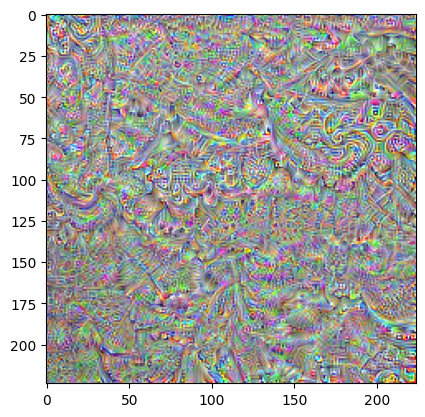

In [6]:
# plt.imshow(visualise_layer_filter(model, 23, 19)) # picked a random one
plt.imshow(visualise_layer_filter(model, 42, 12)) # picked a random one

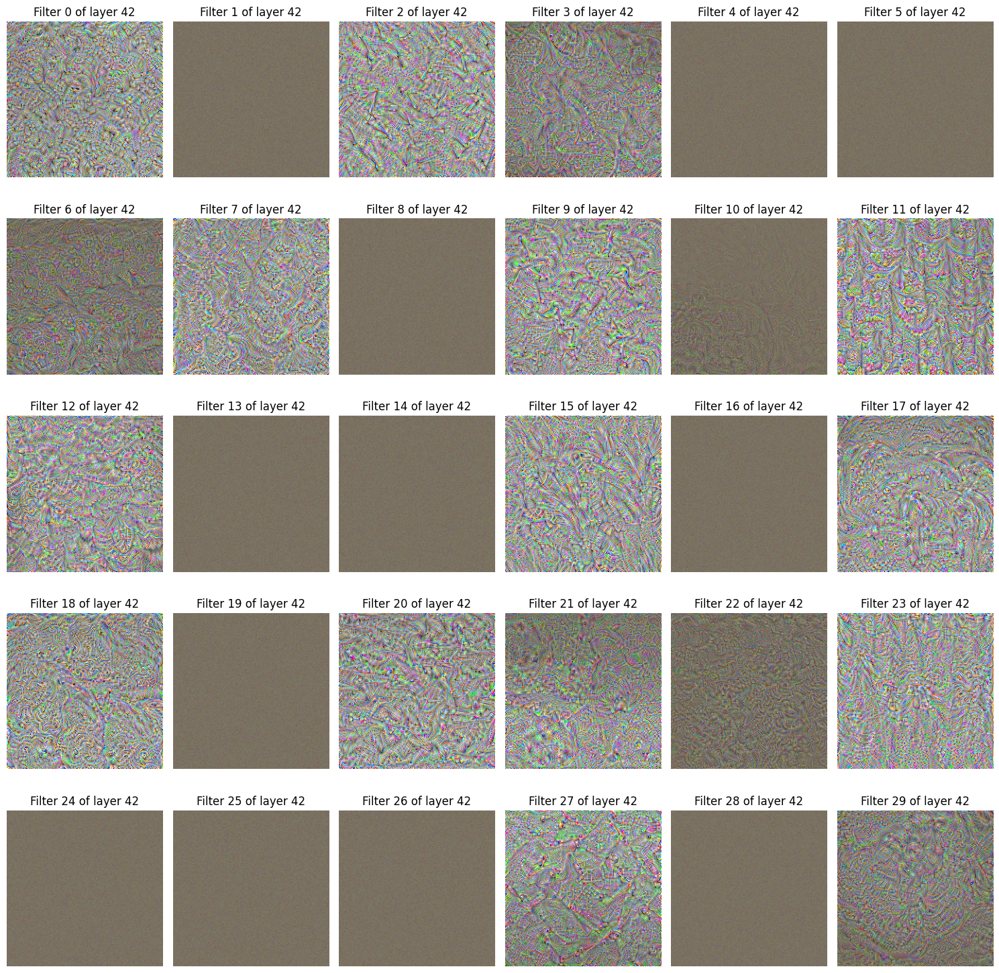

In [7]:
num_filters = 30  # Number of filters to visualize

index_layer = 42

num_cols = 6
num_rows = num_filters // num_cols

fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 15))
axes = axes.flatten()
for i in range(num_filters):
    filter_activation = visualise_layer_filter(model, index_layer, i)
    
    axes[i].imshow(filter_activation, cmap='viridis',)
    axes[i].axis('off')
    axes[i].set_title(f"Filter {i} of layer {index_layer}")
plt.tight_layout()
plt.show()

## Task 1.4 - Visualize filters at different layers.

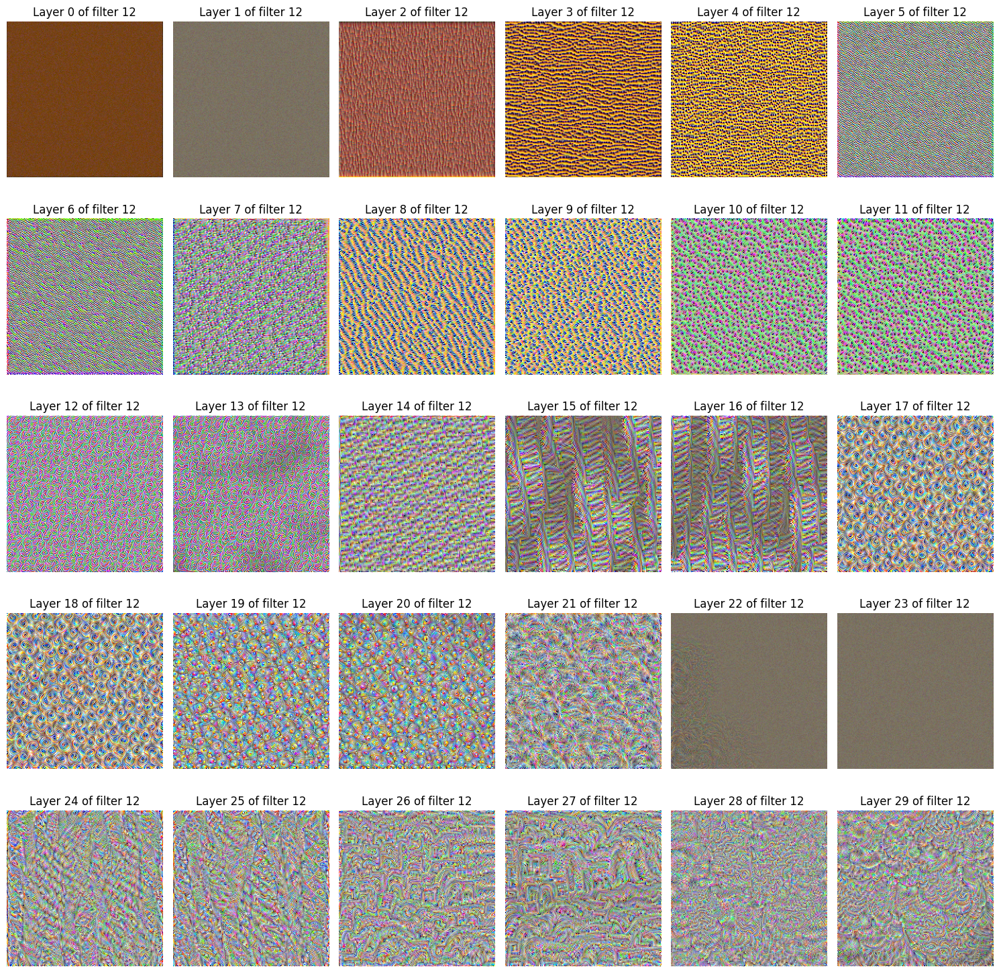

In [8]:
num_layers = 30  # Number of filters to visualize
index_filter = 12

num_cols = 6
num_rows = num_layers // num_cols

fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 15))
axes = axes.flatten()
for i in range(num_layers):
    filter_activation = visualise_layer_filter(model, i, index_filter)
    axes[i].imshow(filter_activation, cmap='viridis')
    axes[i].axis('off')
    axes[i].set_title(f"Layer {i} of filter {index_filter}")
plt.tight_layout()
plt.show()

> What do you observe going from earlier layers to later layers?

Type of feature recognition (extraction) changes:
- Early Layers: low level features (textures) w/ high spatial resolution
- Intermediate Layers: more complex patterns s.a. corners, edges (combinations of the low-level features)
- Later Layers: capture high-level features such as parts of objects (reduced spatial resolution, invariance to minor changes)

## Task 1.5 - Hyperparameter tuning.


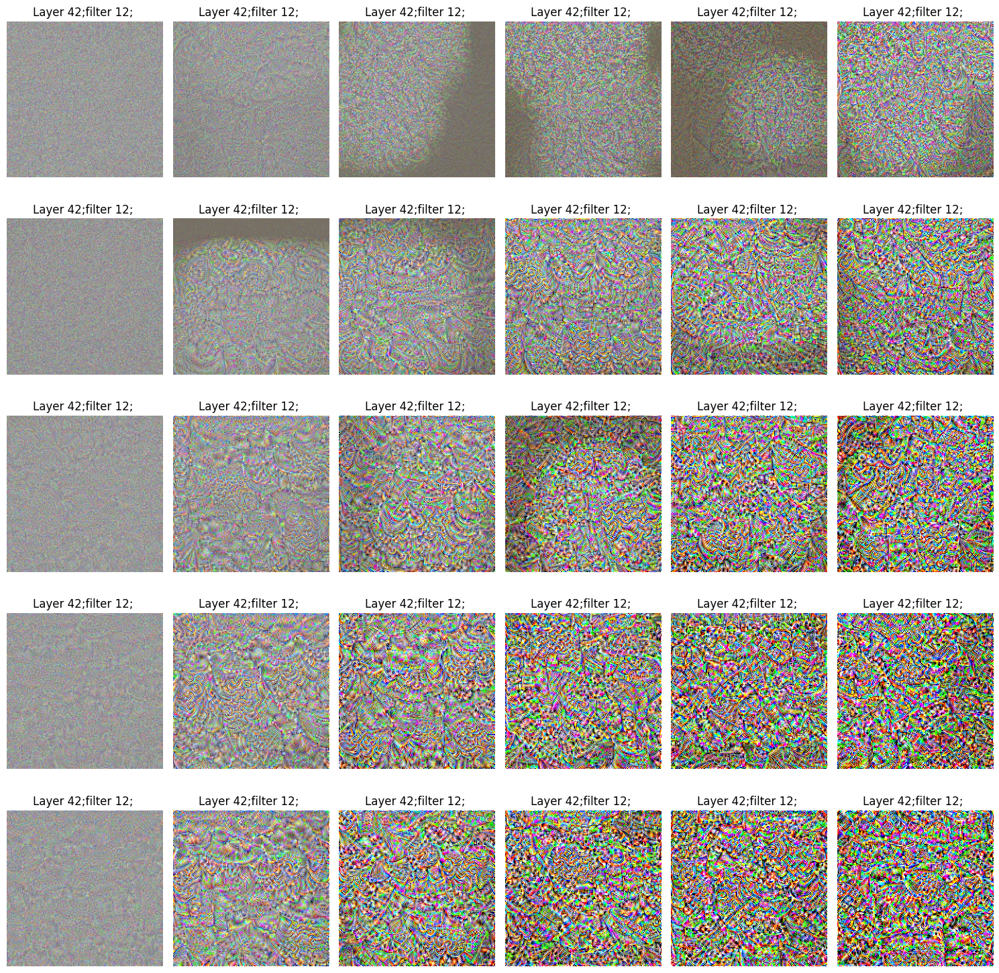

In [9]:
range_lr = np.linspace(0.01, 0.3, 6)
range_num_optim_steps = range(10, 60, 10)

index_layer = 42
index_filter = 12

num_cols = 6
num_rows = num_layers // num_cols

fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 15))
axes = axes.flatten()
for i, num_optim_steps in enumerate(range_num_optim_steps):
    for j, lr in enumerate(range_lr):
        index = i*num_cols+j
        filter_activation = visualise_layer_filter(model, index_layer, index_filter, num_optim_steps, lr)
        axes[index].imshow(filter_activation, cmap='viridis')
        axes[index].axis('off')
        axes[index].set_title(f"Layer {index_layer};filter {index_filter}; ")
plt.tight_layout()
plt.show()

## Task 1.6 - Pretrained weights.


/Users/flyboy/Documents/LMU/SoSe 25/GenAI/.venv/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


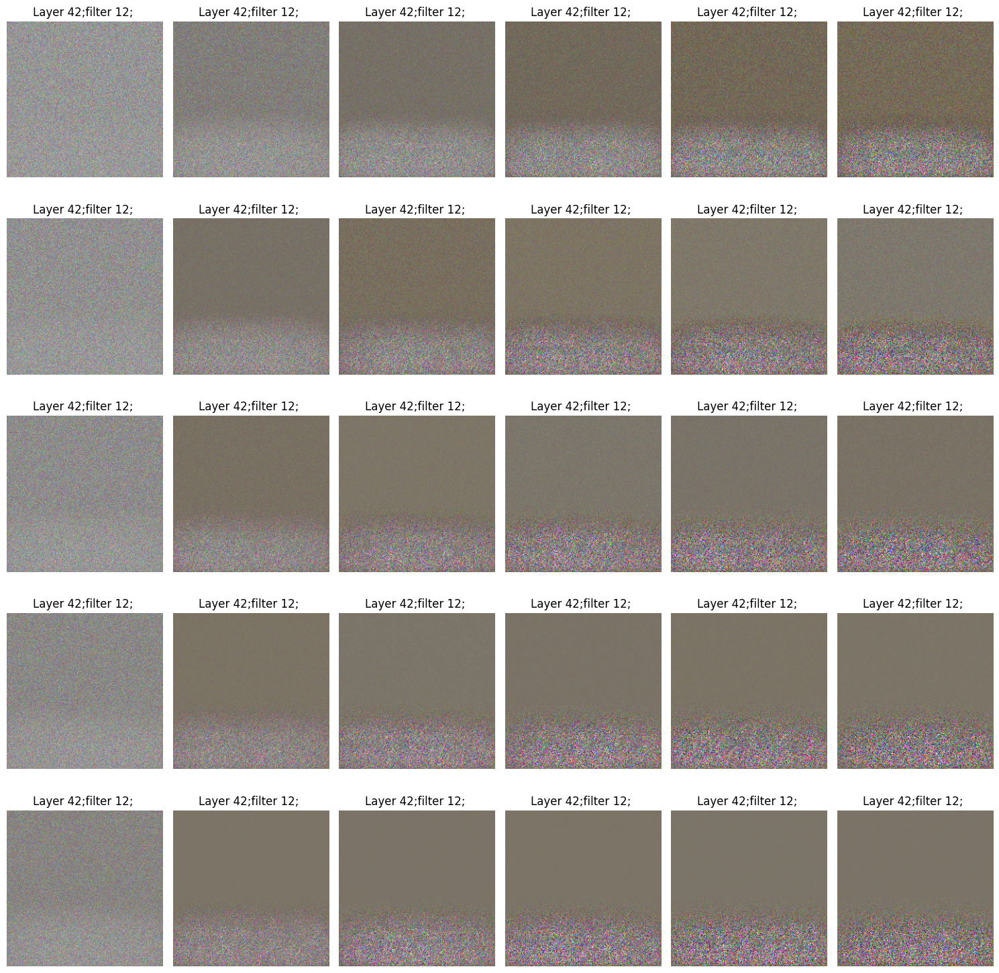

In [10]:
untrained_model = models.vgg16(pretrained=False).features

range_lr = np.linspace(0.01, 0.3, 6)
range_num_optim_steps = range(10, 60, 10)

index_layer = 42
index_filter = 12

num_cols = 6
num_rows = num_layers // num_cols

fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 15))
axes = axes.flatten()
for i, num_optim_steps in enumerate(range_num_optim_steps):
    for j, lr in enumerate(range_lr):
        index = i*num_cols+j
        filter_activation = visualise_layer_filter(untrained_model, index_layer, index_filter, num_optim_steps, lr)
        axes[index].imshow(filter_activation, cmap='viridis')
        axes[index].axis('off')
        axes[index].set_title(f"Layer {index_layer};filter {index_filter}; ")
plt.tight_layout()
plt.show()

> What do you observe?

No feature visible, no pattern recognition.

# Task 2: Deep Dream

## Task 1.1 Most activated filters for every image

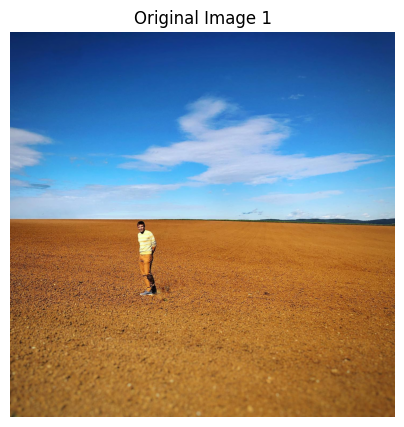

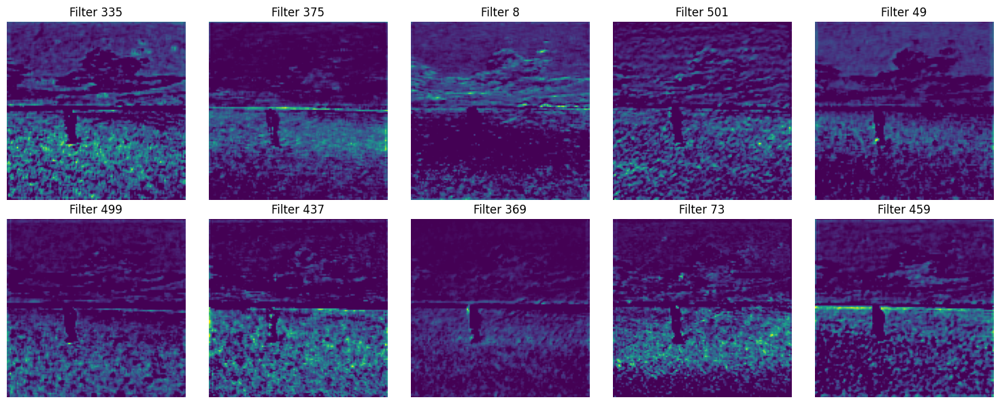

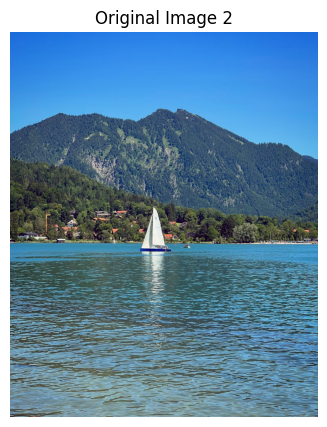

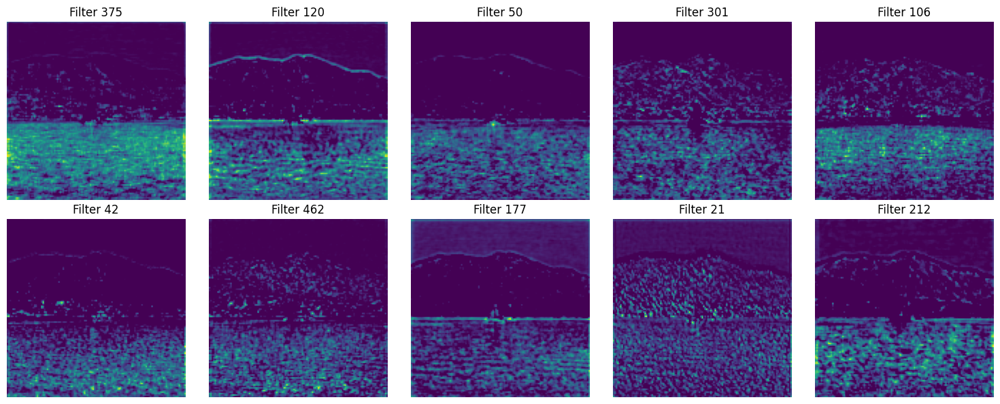

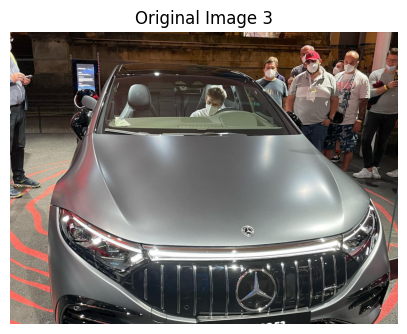

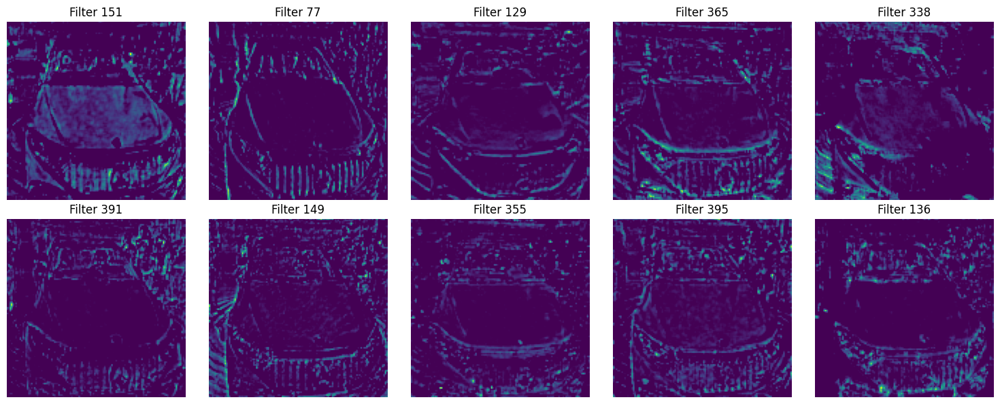

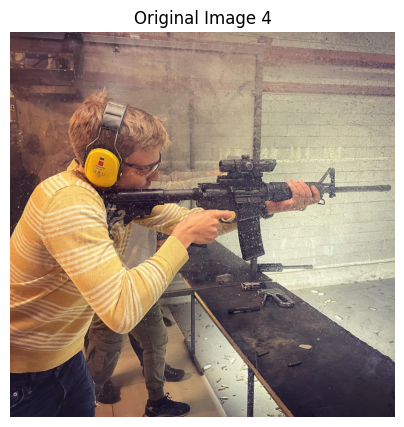

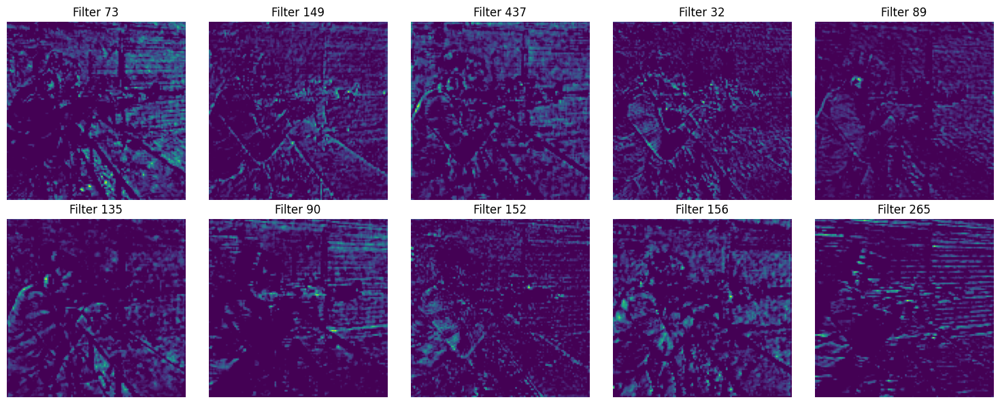

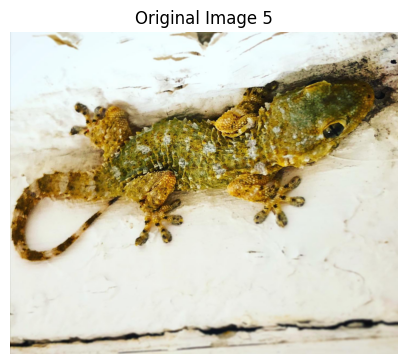

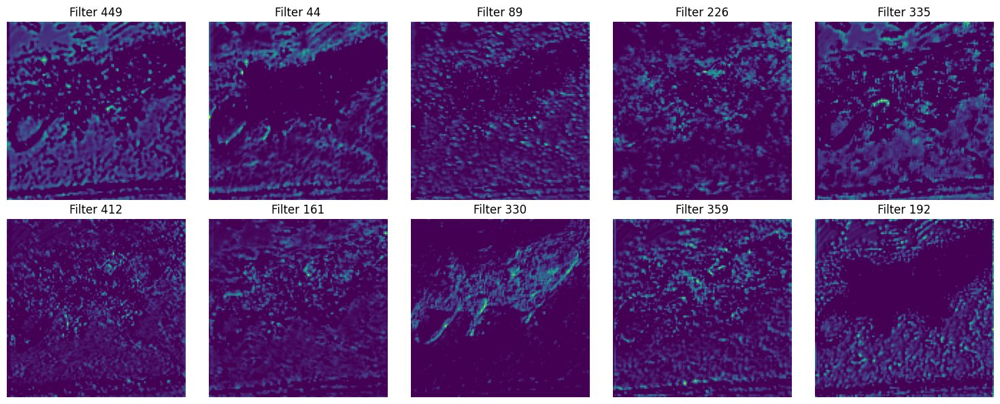

In [23]:
import torch
import torch.nn as nn
import torchvision.models as models
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import os

model.eval()

# Function to get activations from a specific layer (from Task 1)
def get_activations(model, layer_idx, input_tensor):
    activations = {}

    def hook(module, input, output):
        activations["value"] = output.detach()

    hook_handle = model[layer_idx].register_forward_hook(hook)
    model(input_tensor)
    hook_handle.remove()
    return activations["value"]


# Load and preprocess image
def load_image(image_path):
    img = Image.open(image_path).convert("RGB")
    preprocess = transforms.Compose(
        [
            transforms.Resize((1000, 1000)),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
        ]
    )
    img_tensor = preprocess(img).unsqueeze(0)
    return img, img_tensor

# Define a fixed layer number
layer_idx = 17  # Example layer index (conv4_2 layer in VGG16)

for idx in range(5):
    img, img_tensor = load_image(f"imgs/image{idx+1}.jpg")
    activations = get_activations(model, layer_idx, img_tensor)
    mean_activations = activations.mean(dim=(2, 3)).squeeze()
    top_10_filters = torch.topk(mean_activations, 10).indices

    # Plot the original image
    plt.figure(figsize=(5, 5))
    plt.imshow(img)
    plt.axis("off")
    plt.title(f"Original Image {idx+1}")
    plt.show()

    # Plot the activations of the top 10 filters
    fig, axes = plt.subplots(2, 5, figsize=(15, 6))
    axes = axes.flatten()
    for i, filter_idx in enumerate(top_10_filters):
        filter_activation = activations[0, filter_idx, :, :].cpu().numpy()
        axes[i].imshow(filter_activation, cmap="viridis")
        axes[i].axis("off")
        axes[i].set_title(f"Filter {filter_idx.item()}")
    plt.tight_layout()
    plt.show()

> What do you observe?

We can associate the most activated filters in a specific layer with the predicted class. Those are insights into what features are most relevant for the model's predictions.

## Task 1.2 Total variation loss.

$$
TV(I)=\sum_{i,j}\sqrt{|I_{i+1,j}-I_{i,j}|^2+|I_{i,j+1}-I_{i,j}|^2}
$$

In [44]:
import numpy as np
import os
import torch
from torch.optim import Adam
from torchvision import models
import matplotlib.pyplot as plt
from PIL import Image
import torchvision.transforms as transforms

from aux_ops import preprocess_image, recreate_image, save_image


In [45]:

def total_variation_loss(img, weight):
    tv_loss = weight * (
        torch.sum(torch.abs(img[:, :, :-1] - img[:, :, 1:])) +
        torch.sum(torch.abs(img[:, :-1, :] - img[:, 1:, :]))
    )
    return tv_loss

def load_real_image(image_path):
    img = Image.open(image_path).convert('RGB')
    preprocess = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ])
    img_tensor = preprocess(img).unsqueeze(0)
    img_tensor = torch.tensor(img_tensor, device=device).float()
    img_tensor.requires_grad = True
    return img_tensor


/var/folders/k6/2n5j21yd48z5rh3zjyx3r0ch0000gn/T/ipykernel_3622/90662898.py:16: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img_tensor = torch.tensor(img_tensor, device=device).float()


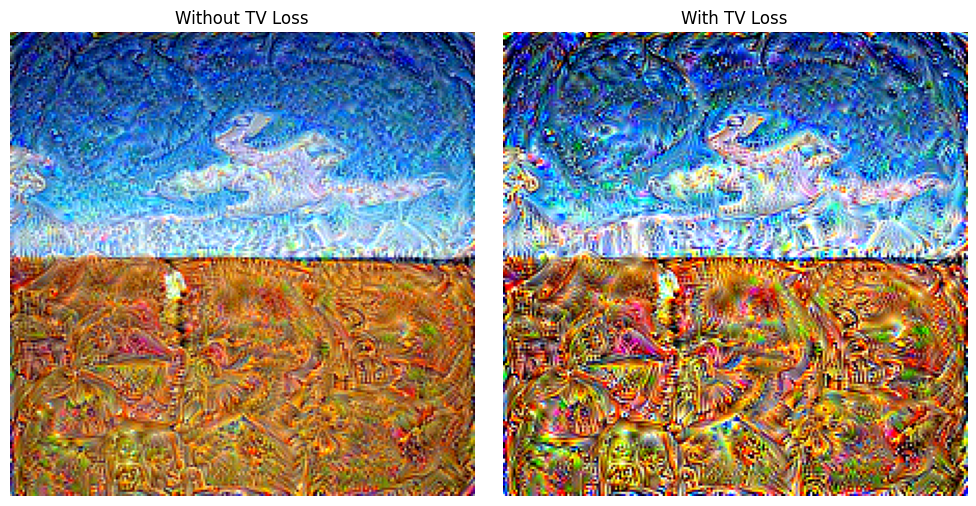

In [46]:

def visualise_layer_filter(model, layer_nmbr, filter_nmbr, img_tensor, tv_weight=None, num_optim_steps=26, lr=0.1):
    processed_image = img_tensor
    optimizer = Adam([processed_image], lr=lr, weight_decay=1e-5)
    
    for i in range(1, num_optim_steps):
        optimizer.zero_grad()
        x = processed_image
        for index, layer in enumerate(model):
            x = layer(x)
            if index == layer_nmbr:
                break

        conv_output = x[0, filter_nmbr]
        loss = -torch.mean(conv_output)
        
        if tv_weight:
            loss_tv = total_variation_loss(processed_image, tv_weight)
            loss += loss_tv

        loss.backward()
        optimizer.step()
        optimized_image = recreate_image(processed_image.cpu())

    return optimized_image

layer_nmbr = 28
filter_nmbr = 228

model = models.vgg16(pretrained=True).features
model.eval()
for param in model.parameters():
    param.requires_grad = False

real_image_path = 'imgs/image1.jpg'  # Replace with your image path
img_tensor = load_real_image(real_image_path)

# Visualize filters with and without TV loss
fig, axes = plt.subplots(1, 2, figsize=(10, 5))

# Optimize without TV loss
img_without_tv = visualise_layer_filter(model, layer_nmbr, filter_nmbr, img_tensor, tv_weight=None)
axes[0].imshow(img_without_tv)
axes[0].axis('off')
axes[0].set_title('Without TV Loss')

# Optimize with TV loss
img_with_tv = visualise_layer_filter(model, layer_nmbr, filter_nmbr, img_tensor, tv_weight=1e-4)
axes[1].imshow(img_with_tv)
axes[1].axis('off')
axes[1].set_title('With TV Loss')

plt.tight_layout()
plt.show()


## Task 1.3 Deep dream.

/var/folders/k6/2n5j21yd48z5rh3zjyx3r0ch0000gn/T/ipykernel_3622/1552776885.py:34: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img_tensor = torch.tensor(img_tensor, device=device).float()


TypeError: only integer tensors of a single element can be converted to an index

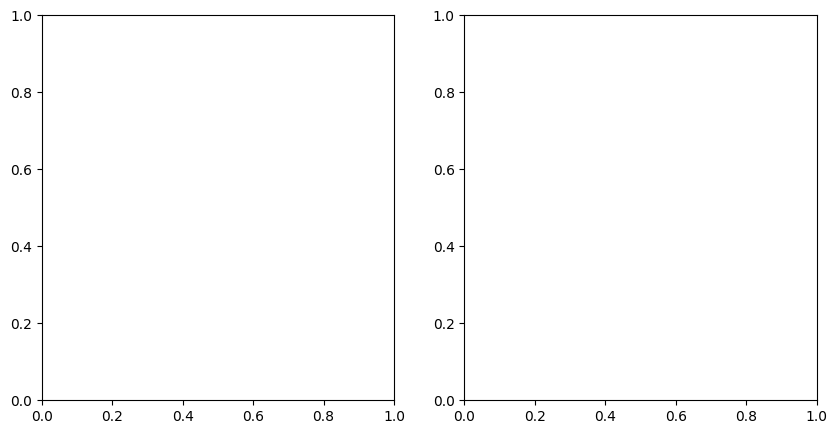

In [60]:
import numpy as np
import os
import torch
from torch.optim import Adam
from torchvision import models
import matplotlib.pyplot as plt
from PIL import Image
import torchvision.transforms as transforms

# Import auxiliary functions
from aux_ops import preprocess_image, recreate_image, save_image

# Initialize GPU if available
use_gpu = torch.cuda.is_available()
# Select device to work on.
device = torch.device("cuda:0" if use_gpu else "cpu")

# Total Variation Loss
def total_variation_loss(img, weight):
    tv_loss = weight * (
        torch.sum(torch.abs(img[:, :, :-1] - img[:, :, 1:])) +
        torch.sum(torch.abs(img[:, :-1, :] - img[:, 1:, :]))
    )
    return tv_loss

def load_real_image(image_path):
    img = Image.open(image_path).convert('RGB')
    preprocess = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ])
    img_tensor = preprocess(img).unsqueeze(0)
    img_tensor = torch.tensor(img_tensor, device=device).float()
    img_tensor.requires_grad = True
    return img_tensor

def deep_dream(model, layer_nmbr, filter_nmbr, img_tensor, tv_weight=None, num_optim_steps=26, lr=0.1):
    processed_image = img_tensor
    optimizer = Adam([processed_image], lr=lr, weight_decay=1e-5)
    
    for i in range(1, num_optim_steps):
        optimizer.zero_grad()
        x = processed_image
        for index, layer in enumerate(model):
            x = layer(x)
            if index == layer_nmbr:
                break

        conv_output = x[0, filter_nmbr]
        loss = -torch.mean(conv_output)
        
        if tv_weight:
            loss_tv = total_variation_loss(processed_image, tv_weight)
            loss += loss_tv

        loss.backward()
        optimizer.step()
        optimized_image = recreate_image(processed_image.cpu())

    return optimized_image

if __name__ == "__main__":
    # Layer indices to be optimized
    layer_indices = [5, 10, 17, 24, 31]  # Example layers (conv layers in VGG16)

    # Fully connected layer is not needed
    model = models.vgg16(pretrained=True).features
    model.eval()
    # Fix model weights
    for param in model.parameters():
        param.requires_grad = False

    # Load a real image
    real_image_path = 'imgs/image1.jpg'  # Replace with your image path
    img_tensor = load_real_image(real_image_path)

    # Visualize deep dream with and without TV loss
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))

    # Optimize without TV loss model, layer_nmbr, filter_nmbr, img_tensor, tv_weight=None
    img_without_tv = deep_dream(model, 20, 12, img_tensor, layer_indices)
    axes[0].imshow(img_without_tv)
    axes[0].axis('off')
    axes[0].set_title('Without TV Loss')

    # Optimize with TV loss
    img_with_tv = deep_dream(model, 20, 12, img_tensor, layer_indices, tv_weight=1e-4)
    axes[1].imshow(img_with_tv)
    axes[1].axis('off')
    axes[1].set_title('With TV Loss')

    plt.tight_layout()
    plt.show()
